In [ ]:
!pip3 install tensorflow==2.8
!pip3 install lime
!pip3 install shap==0.40.0
!pip3 install -q tfimm
!pip3 install -q timm==0.6.13
!pip3 install tensorflow-addons
!pip3 install numba

In [ ]:
from numba import cuda

device = cuda.get_current_device()
device.reset()

In [1]:
import sys, os, glob, pathlib, shap, warnings, tfimm, shutil, time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from lime import lime_image
from skimage.segmentation import mark_boundaries
from skimage.io import imread, imsave
from skimage.util import crop
from skimage.transform import resize

from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef, roc_auc_score

warnings.filterwarnings(action="ignore", message="^internal gelsd")

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers, Model, Input
from tensorflow.keras.preprocessing import image_dataset_from_directory, image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy, KLDivergence
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.data.experimental import cardinality

from tensorflow_addons.optimizers import AdamW

from google.colab import drive
drive.mount('/content/drive')

sys.path.insert(0,'/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/utils')
from gradCam import read_and_transform_img, make_gradcam_heatmap_ViT, display_gradcam
from distillation_ViT import DeiT, ViTDistilled
from distillation import Distiller
from student_vit import StudentViT
from occlusion_maps import OcclusionMaps
from rise import RISE



TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.10.0 and strictly below 2.13.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.8.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/a

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<h1>Load Dataset</h1>

In [ ]:
!unzip -q '/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/datasets/dataset_CD_UC_v5.zip'

In [ ]:
for url in glob.glob('/content/dataset_CD_UC/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 25), (210, 0), (0,0)), copy=False)
  imsave('/content/dataset_CD_UC/ulcerative-colitis/'+url.split('/')[4], crop_img)

In [ ]:
os.mkdir('/content/frames/frames_train')
os.mkdir('/content/frames/frames_test')

os.mkdir('/content/frames/frames_train/crohn-disease')
os.mkdir('/content/frames/frames_train/ulcerative-colitis')

os.mkdir('/content/frames/frames_test/crohn-disease')
os.mkdir('/content/frames/frames_test/ulcerative-colitis')

In [ ]:
for url in glob.glob('/content/frames-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 25), (210, 0), (0,0)), copy=False)
  imsave('/content/frames/frames_test/ulcerative-colitis/'+url.split('/')[3], crop_img)

list_files = [name for name in glob.glob('/content/frames/ulcerative-colitis/*.jpg')]
for a in list_files:
  shutil.move(a, '/content/frames/frames_train/ulcerative-colitis/')

In [ ]:
os.rmdir(pathlib.Path('/content/frames/ulcerative-colitis'))
!rm -r '/content/dataset_CD_UC/ulcerative-colitis-crop/'
!rm -r '/content/frames-crop/'

In [2]:
data_dir = pathlib.Path('/content/dataset_CD_UC')
data_dir_frames_train = pathlib.Path('/content/frames/frames_train')
data_dir_frames_test = pathlib.Path('/content/frames/frames_test')

# Input size initial
batch_size = 32
IMG_SIZE = (224, 224)

# Distillation
BASE_LR = 1e-5
WEIGHT_DECAY = 0.0001
lr_scaled = (BASE_LR / 512) * batch_size

train_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.7,
  subset="training",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_batches = cardinality(val_ds)
test_ds = val_ds.take((2*val_batches) // 3)    #Take 20% for test
val_ds = val_ds.skip((2*val_batches) // 3)   #Take 10% for validation

class_names = train_ds.class_names

print(class_names)

Found 2649 files belonging to 2 classes.
Using 795 files for training.
Found 2649 files belonging to 2 classes.
Using 794 files for validation.
['crohn-disease', 'ulcerative-colitis']


In [3]:
frames_train = image_dataset_from_directory(data_dir_frames_train,image_size=IMG_SIZE,batch_size=batch_size)
frames_test = image_dataset_from_directory(data_dir_frames_test,image_size=IMG_SIZE,batch_size=batch_size)

train_ds = train_ds.concatenate(frames_train)
test_ds = test_ds.concatenate(frames_test)

Found 34 files belonging to 2 classes.
Found 30 files belonging to 2 classes.


Found 2649 files belonging to 2 classes.


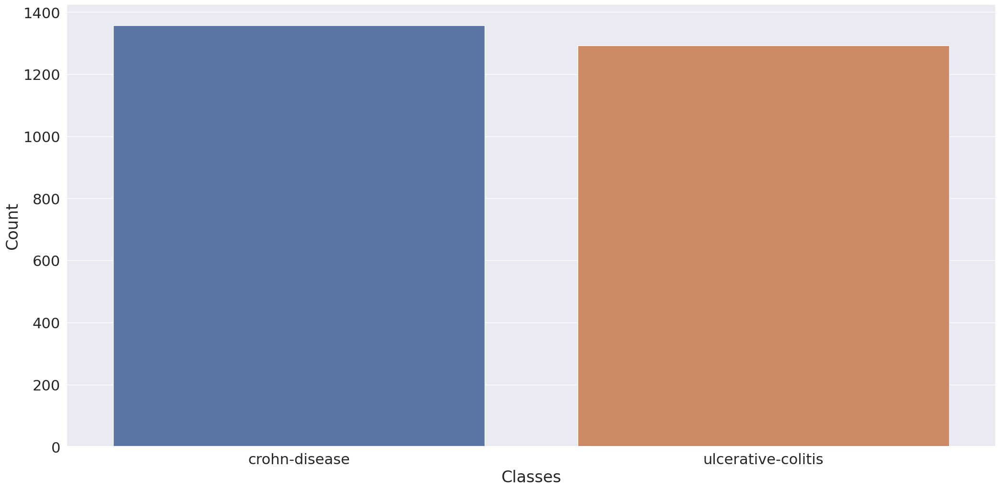

In [ ]:
def class_distribution(dataset):
    class_values = []
    total_batches = dataset.__len__().numpy()
    for batch, element in enumerate(dataset.as_numpy_iterator()):
        if batch+1 == total_batches:
            for i in range(len(element[1])):
                class_values.append(class_names[int(element[1][i])])
        else:
            for i in range(batch_size):
                class_values.append(class_names[int(element[1][i])])

    class_n, frequency = np.unique(np.array(class_values), return_counts=True)
    count = pd.DataFrame(columns=["Classes","Count"])
    count["Classes"] = class_n
    count["Count"] = frequency
    return count, class_values

dataset1 = image_dataset_from_directory(data_dir)

df_class_dist, class_df_values_val = class_distribution(dataset1)
plt.figure(figsize=(25, 12))
sns.set(font_scale=2.0)
sns.barplot(data=df_class_dist, y="Count" ,x="Classes");
plt.show()

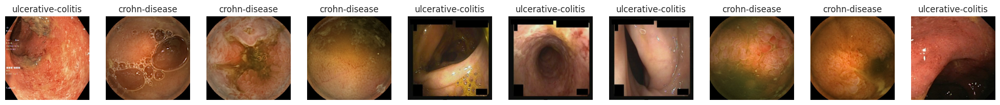

In [ ]:
plt.figure(figsize=(25, 15))
for images, labels in train_ds.take(1):
    for i in range(10):
        ax = plt.subplot(2, 10, i + 1)
        sns.set(font_scale=1.0)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

<h1>Classificiation</h1>

In [4]:
data_augmentation = Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
  layers.RandomContrast(0.15),
  layers.RandomZoom(-.2,-.3)
])

In [5]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5)
sns.set(font_scale=1.0)

In [6]:
images, labels = tuple(zip(*val_ds))

true_images = np.concatenate(images)
true_labels = np.concatenate(labels)

<h1>Student model</h1>

In [7]:
inputs = Input(shape=IMG_SIZE+(3,))
outputs = ViTDistilled().call(inputs)
student_model_1 = Model(inputs, outputs)

student_model_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 tf.compat.v1.shape (TFOpLambda  (4,)                0           ['input_1[0][0]']                
 )                                                                                                
                                                                                                  
 tf.__operators__.getitem (Slic  ()                  0           ['tf.compat.v1.shape[0][0]']     
 ingOpLambda)                                                                                 

In [8]:
inputs = Input(shape=IMG_SIZE+(3,))
x = data_augmentation(inputs)
x = layers.Rescaling(1./255)(x)
outputs = StudentViT(32).call(x)
student_model_2 = Model(inputs, outputs)

student_model_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_6[0][0]']                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['sequential[0][0]']             
                                                                                                  
 patches (Patches)              (None, None, 3072)   0           ['rescaling[0][0]']        

<h1>Images to Interpretability</h1>

In [ ]:
for url in glob.glob('/content/test/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 25), (210, 0), (0,0)), copy=False)
  imsave('/content/test/ulcerative-colitis/'+url.split('/')[4], crop_img)

In [ ]:
!rm -r '/content/test/ulcerative-colitis-crop/'

In [9]:
dir = pathlib.Path('/content/test')
interpretability_data = image_dataset_from_directory(dir, image_size=IMG_SIZE, batch_size=batch_size)
print(interpretability_data.class_names)

images_exp, labels_exp = tuple(zip(*interpretability_data))

image_interpretability_5_1 = np.concatenate(images_exp)
labels_interpretability_5_1 = np.concatenate(labels_exp)

Found 6 files belonging to 2 classes.
['crohn-disease', 'ulcerative-colitis']


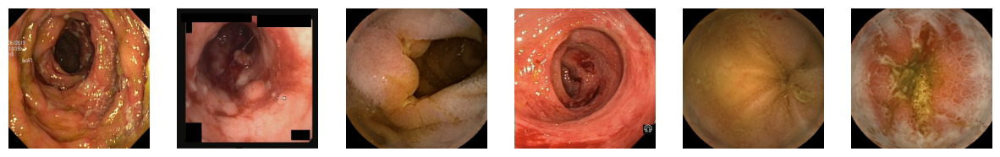

In [10]:
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  ax.imshow(img_array[0].astype(np.uint8))
  ax.axis('off')

In [11]:
print('*** Ground truth ***\n')
for val in labels_interpretability_5_1:
  if val == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

*** Ground truth ***

ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease


# ViT_B/32

In [ ]:
vit_model = tfimm.create_model("vit_base_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_preprocessing = tfimm.create_preprocessing("vit_base_patch32_224_in21k")

inputs = Input(shape=(224, 224,3))
x = data_augmentation(inputs)
x = vit_model_preprocessing(x)
x = vit_model.call(x)
outputs = layers.Dense(len(class_names))(x)
model_vit_b32 = Model(inputs, outputs)

In [ ]:
model_vit_b32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history = model_vit_b32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 30s 535ms/step - loss: 0.1226 - accuracy: 0.9457 - val_loss: 0.0731 - val_accuracy: 0.9760
Epoch 2/200
27/27 [==============================] - 14s 496ms/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 0.0186 - val_accuracy: 0.9926
Epoch 3/200
27/27 [==============================] - 13s 450ms/step - loss: 8.3488e-04 - accuracy: 1.0000 - val_loss: 0.0127 - val_accuracy: 0.9926
Epoch 4/200
27/27 [==============================] - 13s 467ms/step - loss: 4.8292e-04 - accuracy: 1.0000 - val_loss: 0.0101 - val_accuracy: 0.9963
Epoch 5/200
27/27 [==============================] - 14s 495ms/step - loss: 3.9402e-04 - accuracy: 1.0000 - val_loss: 0.0100 - val_accuracy: 0.9982
Epoch 6/200
27/27 [==============================] - 13s 470ms/step - loss: 0.0044 - accuracy: 0.9988 - val_loss: 0.0102 - val_accuracy: 0.9963
Epoch 7/200
27/27 [==============================] - 13s 457ms/step - loss: 5.9078e-04 - accuracy: 1.0000 - val_loss: 0.0019

<Axes: >

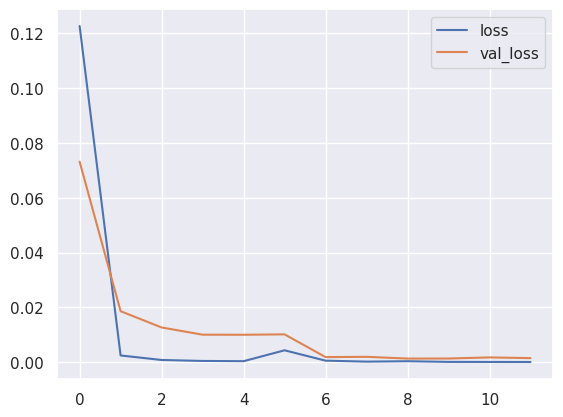

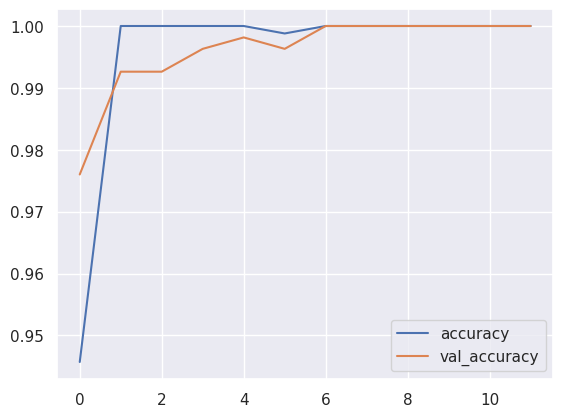

In [ ]:
model_history = pd.DataFrame(history.history)
model_history.loc[:, ['loss', 'val_loss']].plot()
model_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history['val_loss'].mean()))

Accuracy for Train: 0.9954
Loss for Train: 0.0111
Accuracy for Test: 0.9960
Loss for Test: 0.0120


In [ ]:
start = time.time()
predict_labels_ = model_vit_b32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels = np.argmax(model_vit_b32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels)))

Accuracy: 1.0000
Loss: 0.0028
Inference Time: 4.52s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


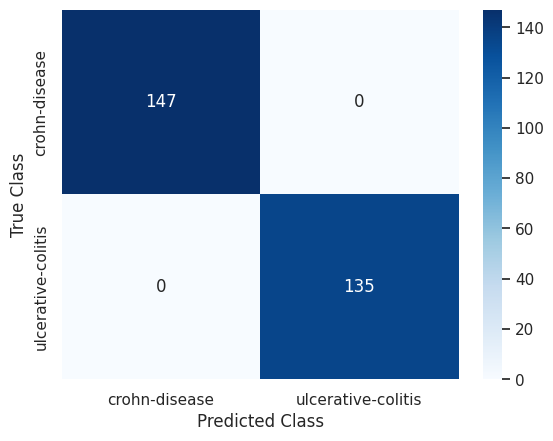

In [ ]:
conf_matrix = pd.DataFrame(confusion_matrix(true_labels, predict_labels), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h2>Knowledge Distillation</h2>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_b32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, batch_size=batch_size, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 17s 296ms/step - accuracy: 0.5344 - student_loss: 1.2571 - distillation_loss: 14.0489 - val_accuracy: 0.5185 - val_student_loss: 0.2344
Epoch 2/100
27/27 [==============================] - 7s 227ms/step - accuracy: 0.5585 - student_loss: 1.1409 - distillation_loss: 13.2564 - val_accuracy: 0.5387 - val_student_loss: 0.0953
Epoch 3/100
27/27 [==============================] - 8s 274ms/step - accuracy: 0.6441 - student_loss: 0.9144 - distillation_loss: 11.6144 - val_accuracy: 0.9225 - val_student_loss: 0.0892
Epoch 4/100
27/27 [==============================] - 7s 210ms/step - accuracy: 0.8432 - student_loss: 0.3963 - distillation_loss: 6.3154 - val_accuracy: 0.9096 - val_student_loss: 9.6660e-04
Epoch 5/100
27/27 [==============================] - 7s 247ms/step - accuracy: 0.9071 - student_loss: 0.3966 - distillation_loss: 4.8485 - val_accuracy: 0.9649 - val_student_loss: 2.7265e-04
Epoch 6/100
27/27 [==============================] - 

<Axes: >

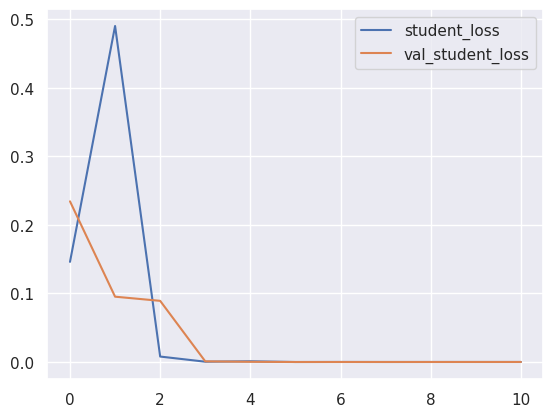

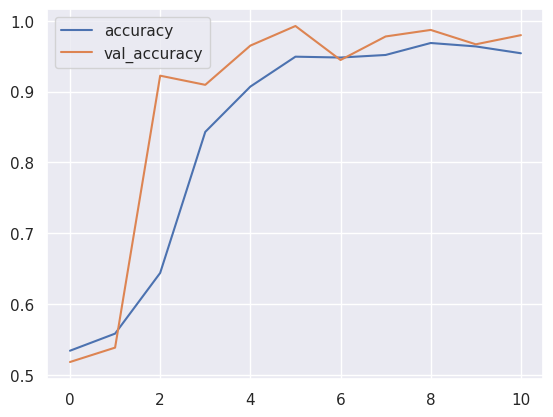

In [ ]:
distiller_history_2 = pd.DataFrame(distillation_history.history)
distiller_history_2.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history_2.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history_2['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history_2['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history_2['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history_2['val_student_loss'].mean()))

Accuracy for Train: 0.8385
Loss for Train: 0.0587
Accuracy for Test: 0.8821
Loss for Test: 0.0382


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9716
Loss: 0.0697
Inference Time: 1.53s
Precision: 0.9774
Recall: 0.9630
F1-Score: 0.9701
AUC: 0.9713
MCC: 0.9432


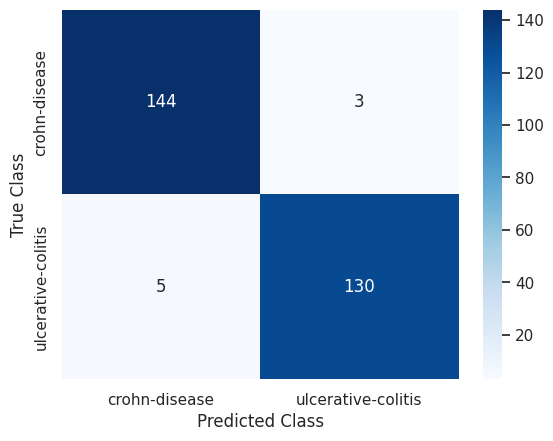

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 33s 444ms/step - accuracy: 0.5097 - student_loss: 0.8328 - distillation_loss: 0.8758 - val_accuracy: 0.8284 - val_student_loss: 0.6301 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 22s 395ms/step - accuracy: 0.5718 - student_loss: 0.7347 - distillation_loss: 0.7909 - val_accuracy: 0.8635 - val_student_loss: 0.5772 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 22s 395ms/step - accuracy: 0.6230 - student_loss: 0.6606 - distillation_loss: 0.7811 - val_accuracy: 0.8395 - val_student_loss: 0.5247 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 23s 416ms/step - accuracy: 0.6996 - student_loss: 0.6216 - distillation_loss: 0.6462 - val_accuracy: 0.8930 - val_student_loss: 0.4591 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 24s 424ms/step - accuracy: 0.7859 - student_loss: 0

<Axes: >

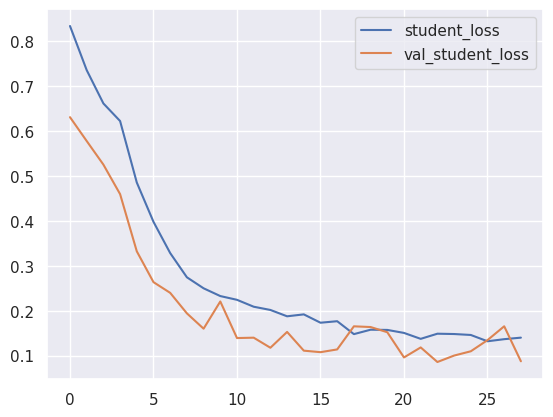

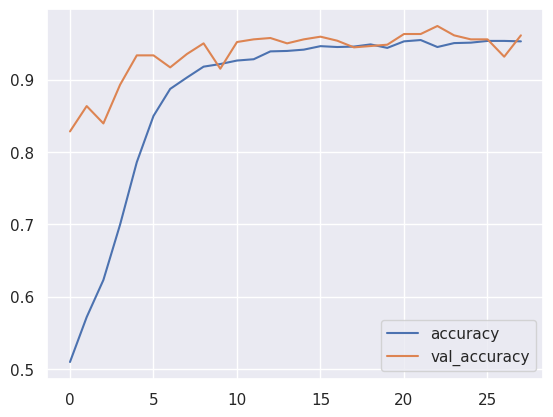

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8817
Loss for Train: 0.2780
Accuracy for Test: 0.9357
Loss for Test: 0.2094


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9574
Loss: 0.1114
Inference Time: 1.14s
Precision: 0.9767
Recall: 0.9333
F1-Score: 0.9545
AUC: 0.9565
MCC: 0.9154


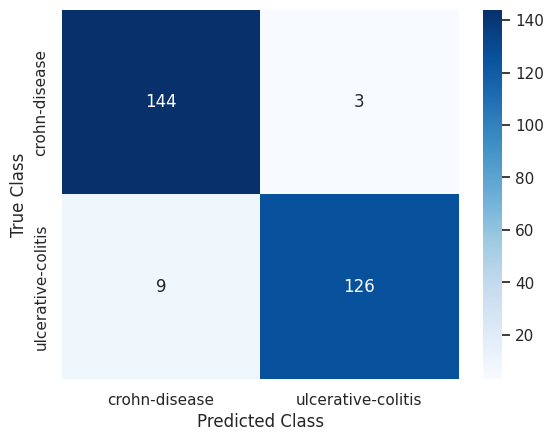

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

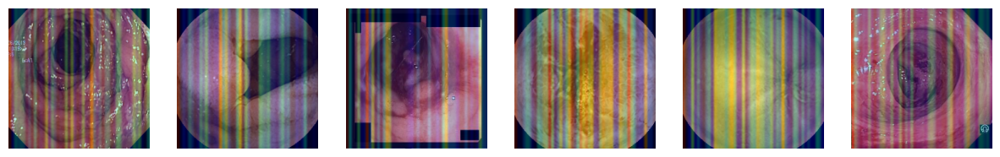

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b32.layers[-1].activation = None

  preds = model_vit_b32.predict(img_array)
  heatmap = make_gradcam_heatmap_ViT(img_array, model_vit_b32, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,50))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

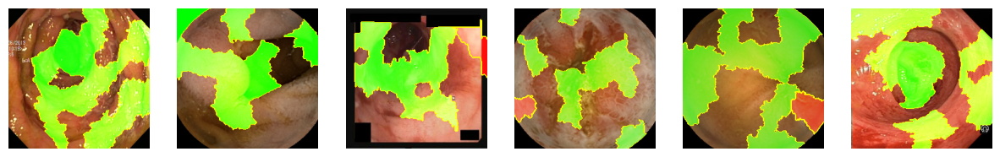

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


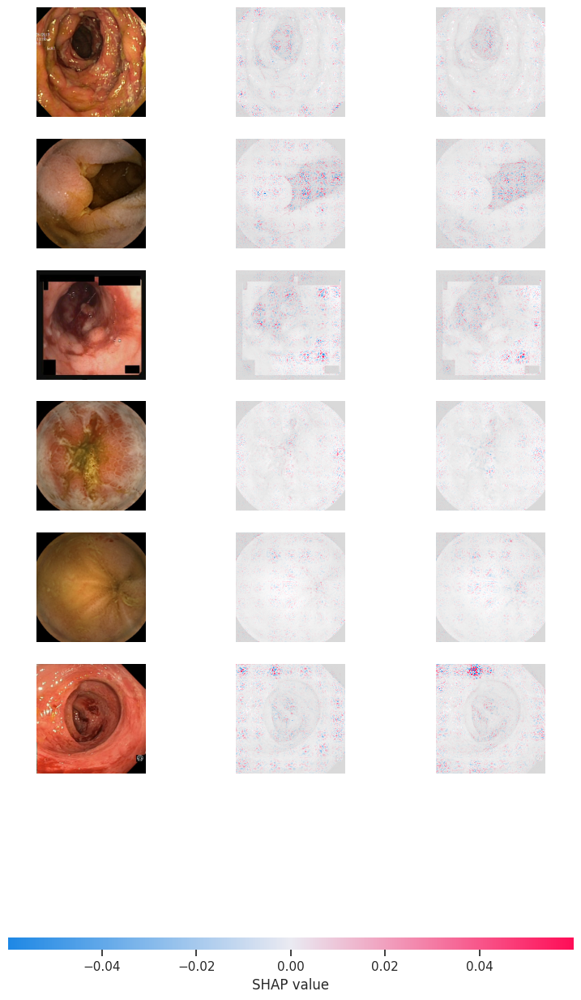

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b32, images_train_1).shap_values(image_interpretability_5_1)
shap.image_plot(shap_values, image_interpretability_5_1)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 390.13it/s]


Explaining: 100%|██████████| 32/32 [00:06<00:00,  5.15it/s]


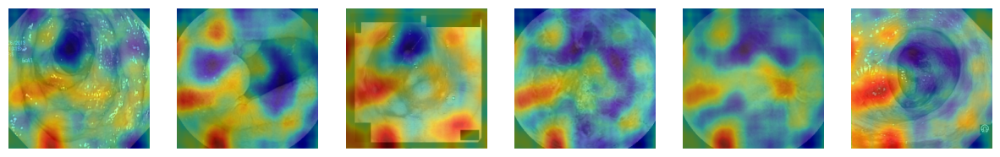

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

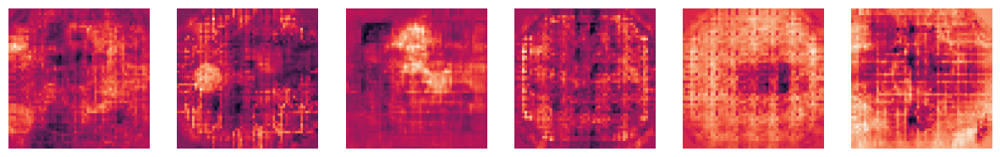

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_b32, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

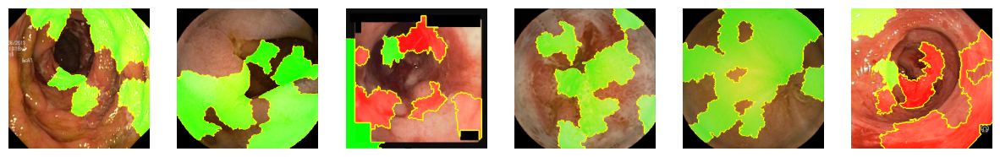

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 414.75it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.55it/s]


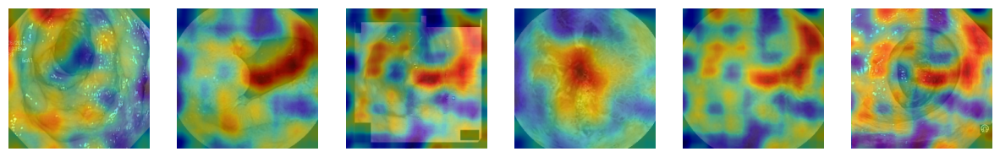

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

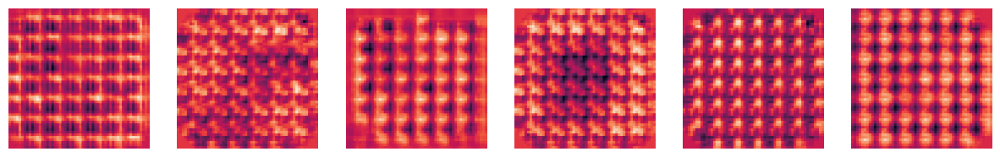

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h2>Interpretability of Second Student</h2>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

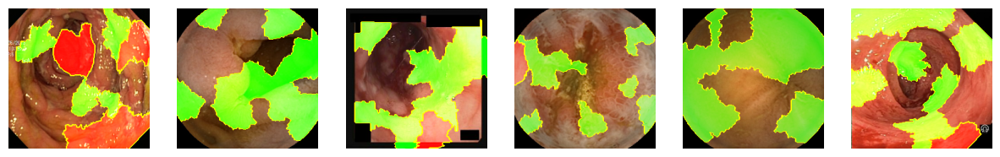

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 416.02it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 12.88it/s]


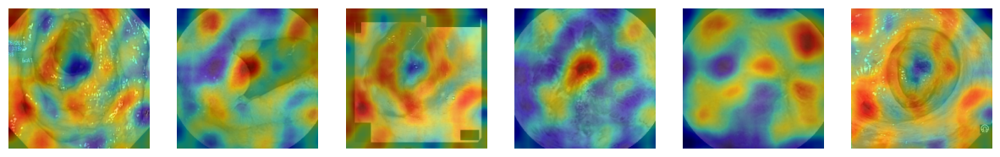

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

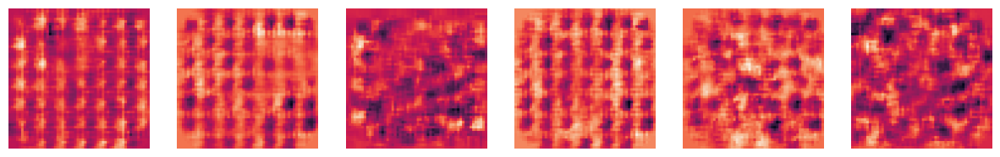

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/32

In [ ]:
vit_model_s32 = tfimm.create_model("vit_small_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_s32_preprocessing = tfimm.create_preprocessing("vit_small_patch32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s32_preprocessing(x)
x = vit_model_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s32 = Model(inputs, outputs)

In [ ]:
model_vit_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_s32 = model_vit_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 25s 384ms/step - loss: 0.1440 - accuracy: 0.9517 - val_loss: 0.0182 - val_accuracy: 0.9908
Epoch 2/200
27/27 [==============================] - 8s 286ms/step - loss: 0.0165 - accuracy: 0.9952 - val_loss: 0.0070 - val_accuracy: 0.9982
Epoch 3/200
27/27 [==============================] - 6s 209ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 0.0059 - val_accuracy: 0.9982
Epoch 4/200
27/27 [==============================] - 8s 260ms/step - loss: 6.4913e-04 - accuracy: 1.0000 - val_loss: 0.0015 - val_accuracy: 1.0000
Epoch 5/200
27/27 [==============================] - 6s 207ms/step - loss: 0.0040 - accuracy: 0.9988 - val_loss: 0.0015 - val_accuracy: 1.0000
Epoch 6/200
27/27 [==============================] - 8s 283ms/step - loss: 6.9373e-04 - accuracy: 1.0000 - val_loss: 0.0018 - val_accuracy: 1.0000
Epoch 7/200
27/27 [==============================] - 6s 211ms/step - loss: 3.8053e-04 - accuracy: 1.0000 - val_loss: 0.0014 - val_acc

<Axes: >

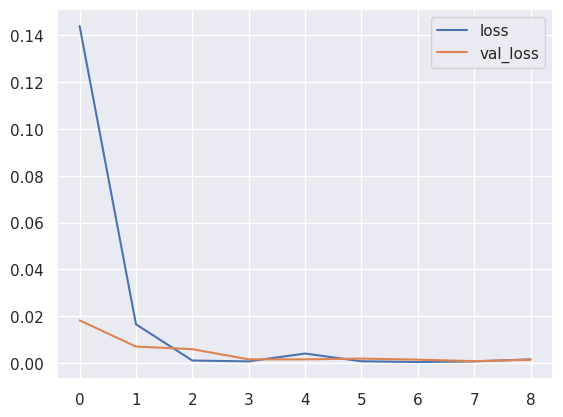

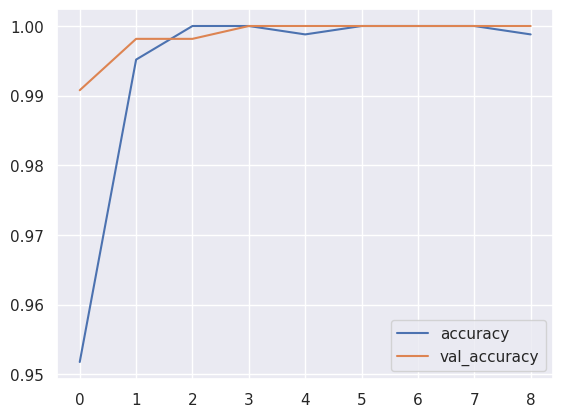

In [ ]:
model_history_s32 = pd.DataFrame(history_s32.history)
model_history_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s32['val_loss'].mean()))

Accuracy for Train: 0.9938
Loss for Train: 0.0188
Accuracy for Test: 0.9986
Loss for Test: 0.0044


In [ ]:
start = time.time()
predict_labels_ = model_vit_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s32 = np.argmax(model_vit_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s32)))

Accuracy: 0.9965
Loss: 0.0051
Inference Time: 2.85s
Precision: 0.9926
Recall: 1.0000
F1-Score: 0.9963
AUC: 0.9966
MCC: 0.9929


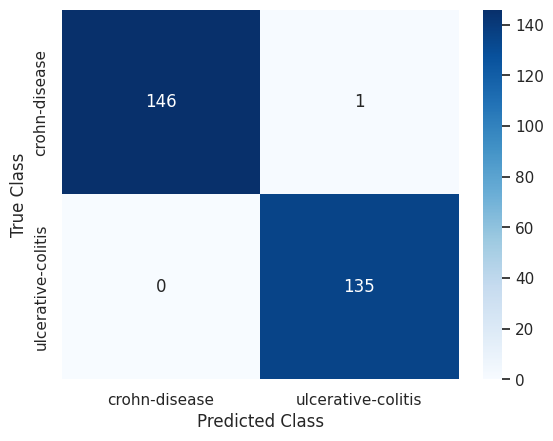

In [ ]:
conf_matrix_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')


ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 19s 290ms/step - accuracy: 0.5211 - student_loss: 1.2417 - distillation_loss: 16.2653 - val_accuracy: 0.9022 - val_student_loss: 0.3924
Epoch 2/100
27/27 [==============================] - 5s 159ms/step - accuracy: 0.7382 - student_loss: 0.6155 - distillation_loss: 10.3069 - val_accuracy: 0.9280 - val_student_loss: 0.2775
Epoch 3/100
27/27 [==============================] - 4s 142ms/step - accuracy: 0.9324 - student_loss: 0.2593 - distillation_loss: 4.8251 - val_accuracy: 0.9760 - val_student_loss: 1.5310e-04
Epoch 4/100
27/27 [==============================] - 6s 192ms/step - accuracy: 0.9457 - student_loss: 0.1400 - distillation_loss: 4.0092 - val_accuracy: 0.9871 - val_student_loss: 1.0951e-05
Epoch 5/100
27/27 [==============================] - 6s 195ms/step - accuracy: 0.9542 - student_loss: 0.1334 - distillation_loss: 3.8796 - val_accuracy: 0.9945 - val_student_loss: 9.4809e-06
Epoch 6/100
27/27 [==============================]

<Axes: >

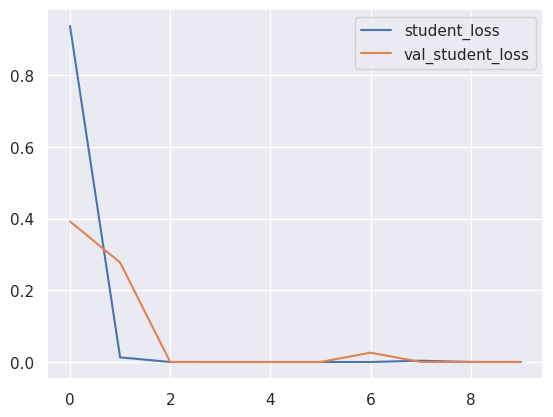

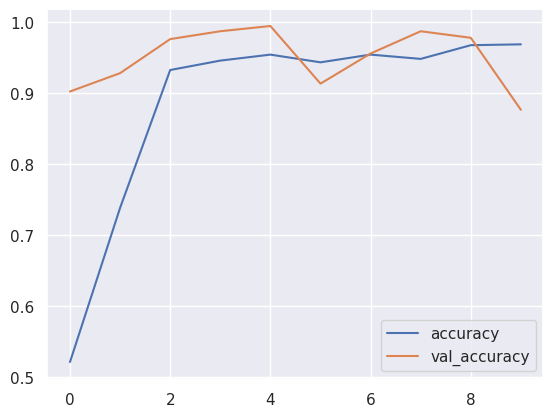

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8873
Loss for Train: 0.0954
Accuracy for Test: 0.9498
Loss for Test: 0.0696


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.8794
Loss: 0.6815
Inference Time: 1.35s
Precision: 0.8024
Recall: 0.9926
F1-Score: 0.8874
AUC: 0.8841
MCC: 0.7808


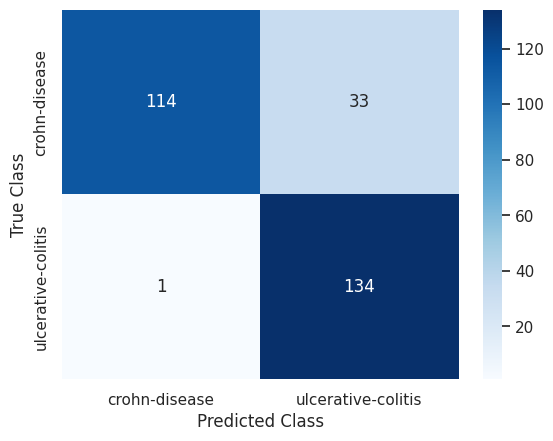

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')


ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 29s 348ms/step - accuracy: 0.5121 - student_loss: 0.9205 - distillation_loss: 0.8648 - val_accuracy: 0.7306 - val_student_loss: 0.5958 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 19s 341ms/step - accuracy: 0.5881 - student_loss: 0.7686 - distillation_loss: 0.7269 - val_accuracy: 0.9354 - val_student_loss: 0.4977 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 20s 369ms/step - accuracy: 0.6834 - student_loss: 0.6807 - distillation_loss: 0.6444 - val_accuracy: 0.9446 - val_student_loss: 0.4261 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 20s 360ms/step - accuracy: 0.7358 - student_loss: 0.6018 - distillation_loss: 0.5895 - val_accuracy: 0.9373 - val_student_loss: 0.3505 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 18s 336ms/step - accuracy: 0.8052 - student_loss: 0

<Axes: >

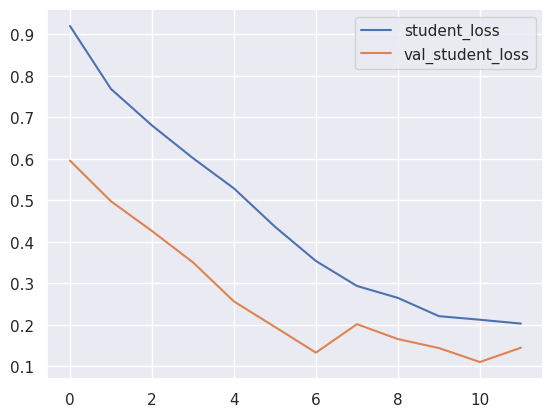

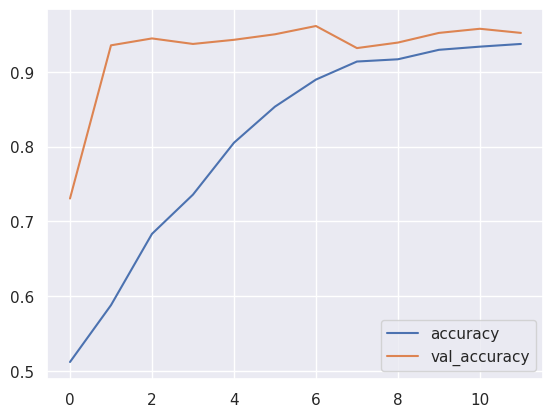

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8082
Loss for Train: 0.4570
Accuracy for Test: 0.9279
Loss for Test: 0.2682


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9468
Loss: 0.1741
Inference Time: 1.10s
Precision: 0.9839
Recall: 0.9037
F1-Score: 0.9421
AUC: 0.9450
MCC: 0.8958


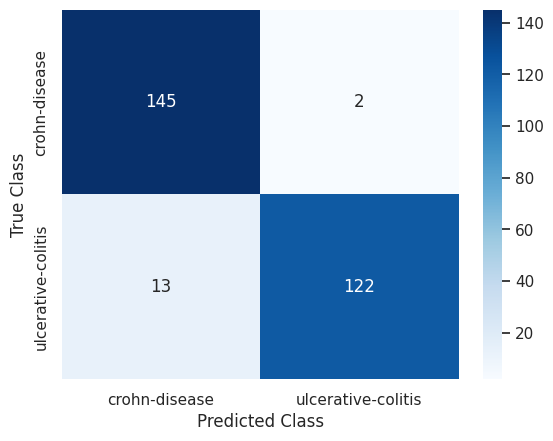

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

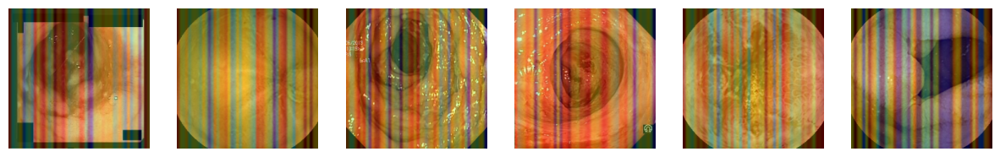

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s32.layers[-1].activation = None

  preds = model_vit_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

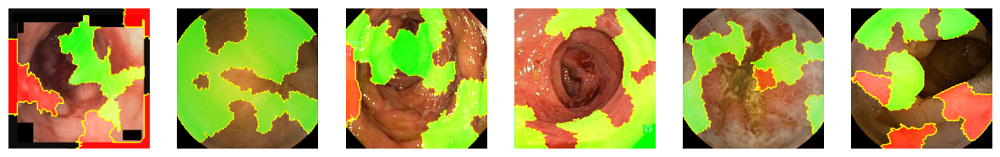

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


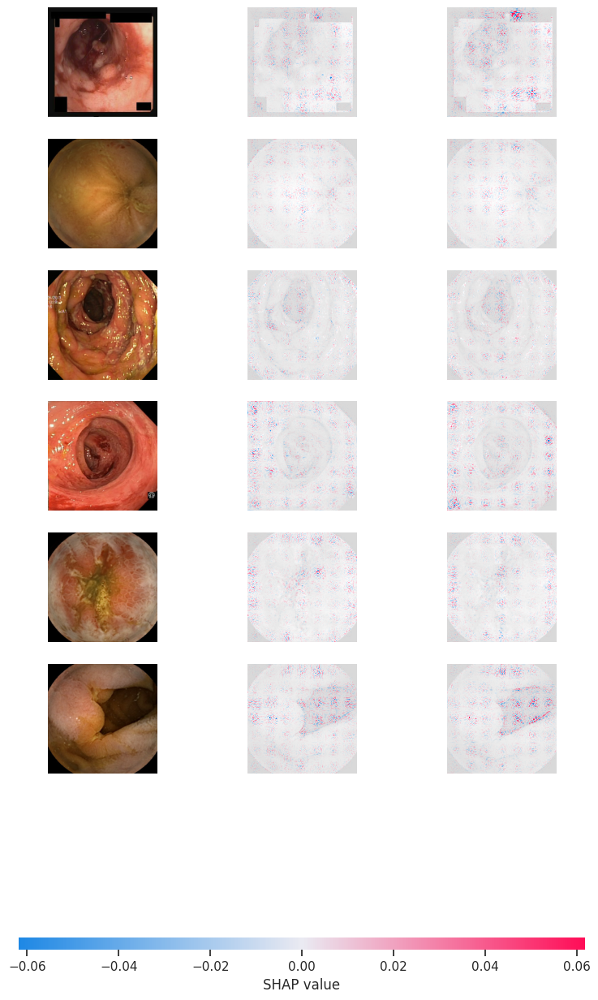

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s32, images_train_1).shap_values(image_interpretability_5_1)
shap.image_plot(shap_values, image_interpretability_5_1)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 256.15it/s]


Explaining: 100%|██████████| 32/32 [00:04<00:00,  7.33it/s]


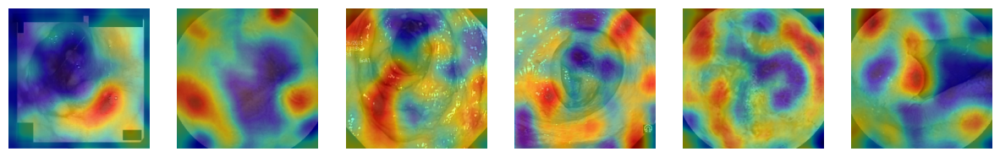

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

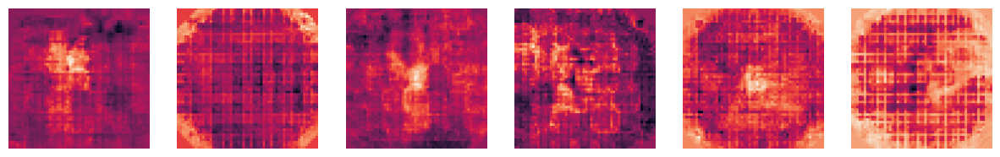

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_s32, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

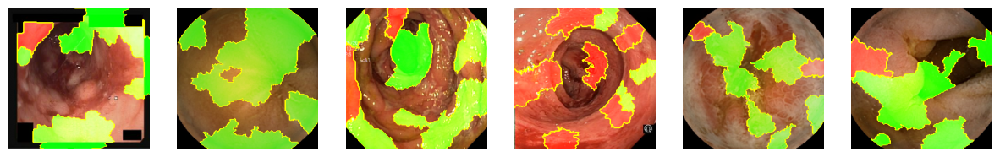

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 417.54it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.88it/s]


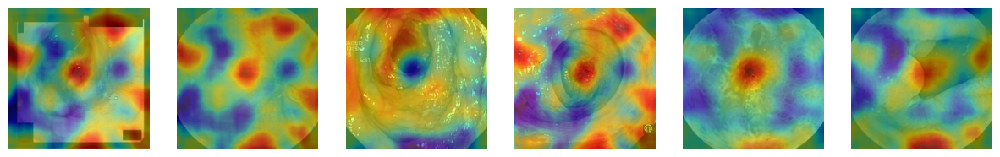

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

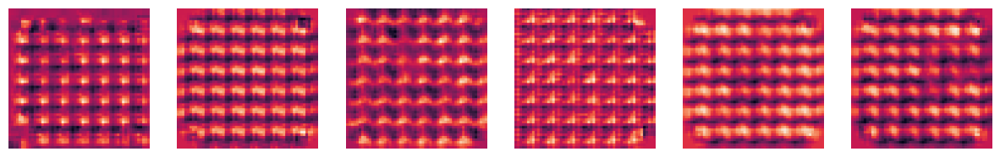

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

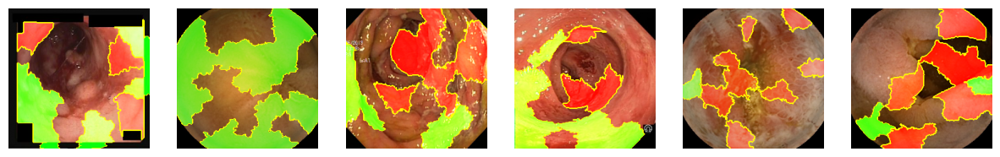

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 407.22it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 15.50it/s]


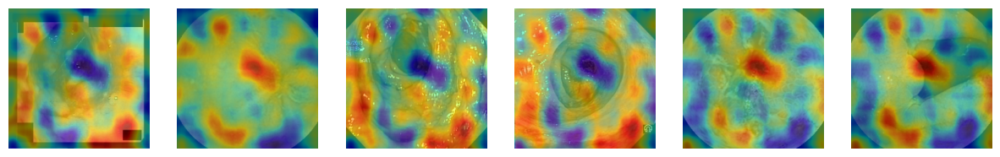

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Maps</h3>

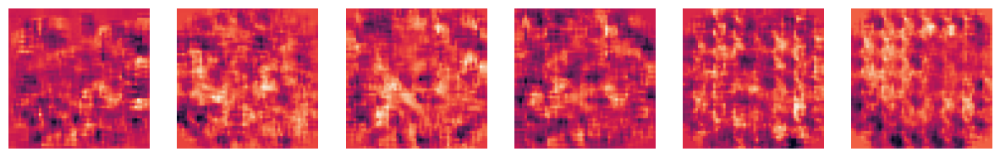

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_B/16

In [ ]:
vit_model_16 = tfimm.create_model("vit_base_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_16_preprocessing = tfimm.create_preprocessing("vit_base_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_16_preprocessing(x)
x = vit_model_16.call(x)
x = layers.Dense(1000, activation="relu")(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_b16 = Model(inputs, outputs)

In [ ]:
model_vit_b16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_b16 = model_vit_b16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 59s 2s/step - loss: 0.2058 - accuracy: 0.9324 - val_loss: 0.0020 - val_accuracy: 1.0000
Epoch 2/200
27/27 [==============================] - 40s 1s/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 9.0756e-05 - val_accuracy: 1.0000
Epoch 3/200
27/27 [==============================] - 42s 2s/step - loss: 3.4449e-04 - accuracy: 1.0000 - val_loss: 2.9641e-04 - val_accuracy: 1.0000
Epoch 4/200
27/27 [==============================] - 42s 2s/step - loss: 1.0958e-04 - accuracy: 1.0000 - val_loss: 9.5013e-04 - val_accuracy: 1.0000
Epoch 5/200
27/27 [==============================] - 40s 1s/step - loss: 6.7792e-05 - accuracy: 1.0000 - val_loss: 7.8448e-04 - val_accuracy: 1.0000
Epoch 6/200
27/27 [==============================] - 41s 2s/step - loss: 7.7027e-05 - accuracy: 1.0000 - val_loss: 9.8638e-04 - val_accuracy: 1.0000


<Axes: >

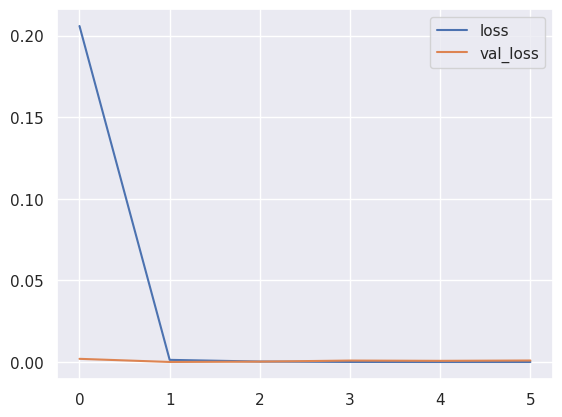

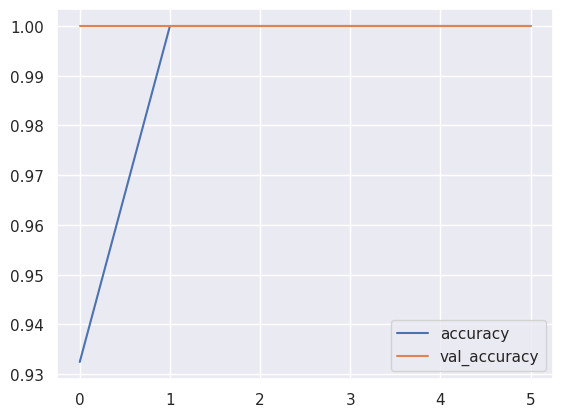

In [ ]:
model_history_b16 = pd.DataFrame(history_b16.history)
model_history_b16.loc[:, ['loss', 'val_loss']].plot()
model_history_b16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_b16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_b16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_b16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_b16['val_loss'].mean()))

Accuracy for Train: 0.9887
Loss for Train: 0.0346
Accuracy for Test: 1.0000
Loss for Test: 0.0009


In [ ]:
start = time.time()
predict_labels_ = model_vit_b16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_b16 = np.argmax(model_vit_b16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_b16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_b16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_b16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_b16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_b16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_b16)))

Accuracy: 1.0000
Loss: 0.0019
Inference Time: 7.72s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


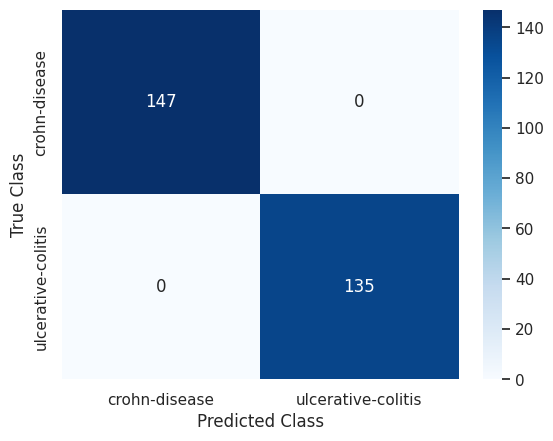

In [ ]:
conf_matrix_b16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_b16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_b16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')


ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ViT = Distiller(student=student_model_2, teacher=model_vit_b16)

distillation_ViT.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history_ViT = distillation_ViT.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 26s 549ms/step - accuracy: 0.6598 - student_loss: 1.0962 - distillation_loss: 18.4536 - val_accuracy: 0.9151 - val_student_loss: 2.0459e-05
Epoch 2/100
27/27 [==============================] - 15s 551ms/step - accuracy: 0.8938 - student_loss: 0.4090 - distillation_loss: 9.0111 - val_accuracy: 0.9908 - val_student_loss: 1.9868e-08
Epoch 3/100
27/27 [==============================] - 16s 555ms/step - accuracy: 0.9373 - student_loss: 0.2310 - distillation_loss: 5.8948 - val_accuracy: 0.9539 - val_student_loss: 9.6892e-04
Epoch 4/100
27/27 [==============================] - 16s 548ms/step - accuracy: 0.9445 - student_loss: 0.1883 - distillation_loss: 5.9364 - val_accuracy: 0.9908 - val_student_loss: 1.2495e-05
Epoch 5/100
27/27 [==============================] - 15s 551ms/step - accuracy: 0.9674 - student_loss: 0.1025 - distillation_loss: 4.6661 - val_accuracy: 0.9834 - val_student_loss: 4.8826e-05
Epoch 6/100
27/27 [====================

<Axes: >

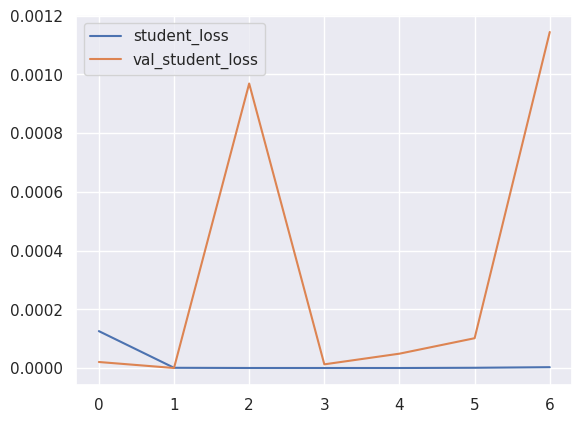

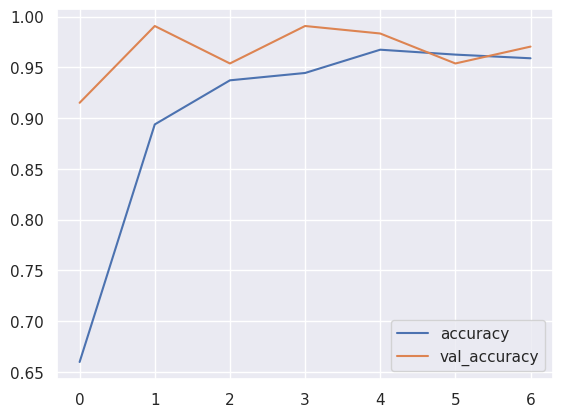

In [ ]:
distiller_history = pd.DataFrame(distillation_history_ViT.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9035
Loss for Train: 0.0000
Accuracy for Test: 0.9655
Loss for Test: 0.0003


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_ViT.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_ViT.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9645
Loss: 0.1487
Inference Time: 1.42s
Precision: 1.0000
Recall: 0.9259
F1-Score: 0.9615
AUC: 0.9630
MCC: 0.9311


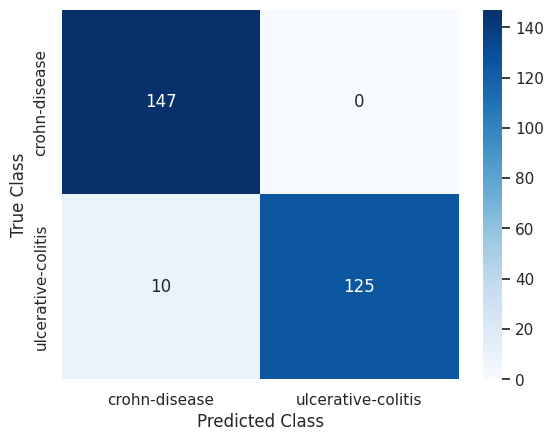

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_ViT.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 55s 783ms/step - accuracy: 0.4940 - student_loss: 0.8051 - distillation_loss: 0.9442 - val_accuracy: 0.4871 - val_student_loss: 0.6959 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 41s 750ms/step - accuracy: 0.5410 - student_loss: 0.7561 - distillation_loss: 0.8152 - val_accuracy: 0.7472 - val_student_loss: 0.6538 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 42s 773ms/step - accuracy: 0.5663 - student_loss: 0.7350 - distillation_loss: 0.7693 - val_accuracy: 0.7306 - val_student_loss: 0.6276 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 42s 768ms/step - accuracy: 0.5844 - student_loss: 0.7181 - distillation_loss: 0.7478 - val_accuracy: 0.8063 - val_student_loss: 0.5949 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 42s 778ms/step - accuracy: 0.6345 - student_loss: 0

<Axes: >

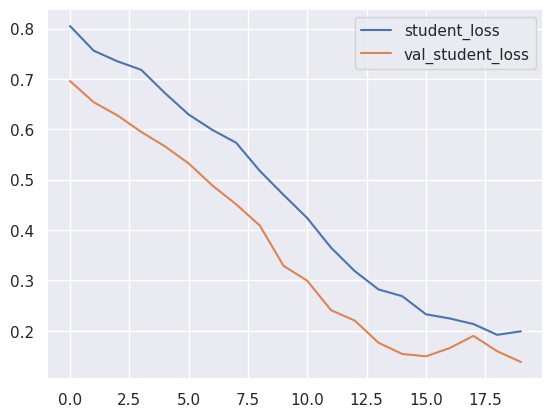

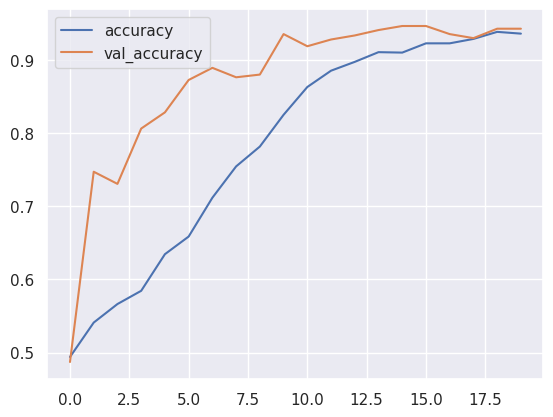

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7834
Loss for Train: 0.4597
Accuracy for Test: 0.8709
Loss for Test: 0.3620


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9433
Loss: 0.2008
Inference Time: 1.37s
Precision: 0.9837
Recall: 0.8963
F1-Score: 0.9380
AUC: 0.9413
MCC: 0.8892


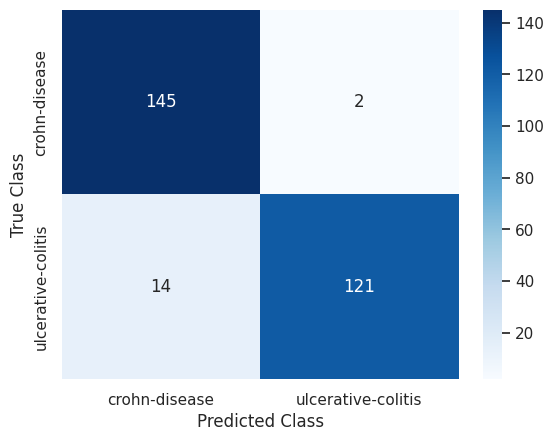

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

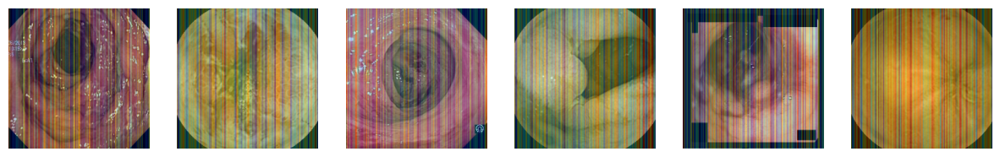

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1[:6], axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b16.layers[-1].activation = None

  preds = model_vit_b16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_b16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

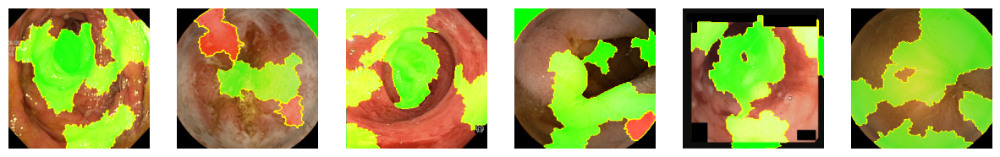

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


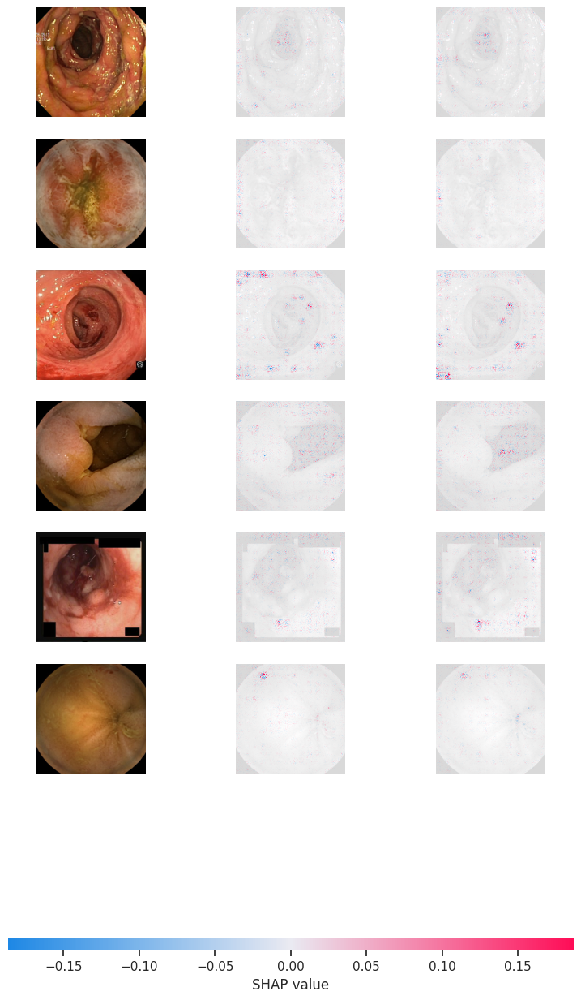

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b16, images_train_1).shap_values(image_interpretability_5_1)
shap.image_plot(shap_values, image_interpretability_5_1)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 365.92it/s]


Explaining: 100%|██████████| 32/32 [00:19<00:00,  1.64it/s]


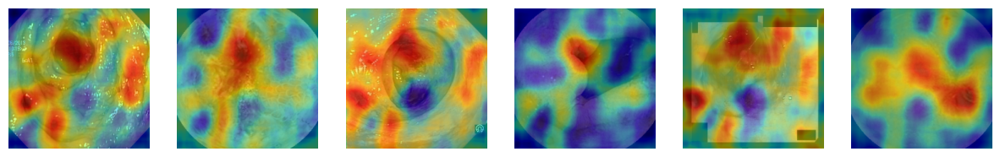

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

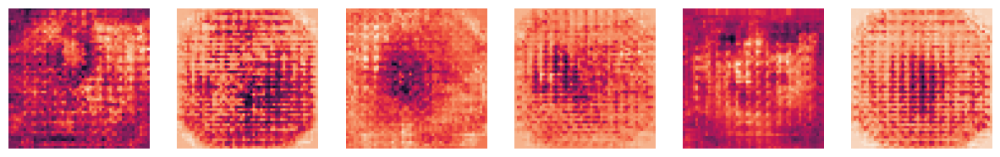

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_b16, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

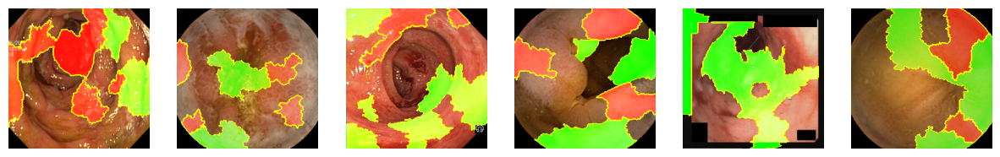

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 253.99it/s]


Explaining: 100%|██████████| 32/32 [00:04<00:00,  7.26it/s]


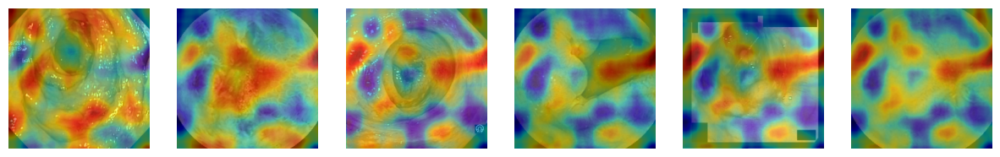

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

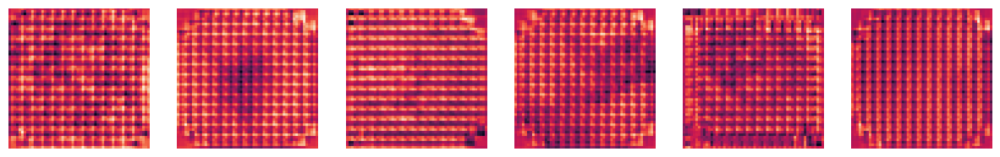

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

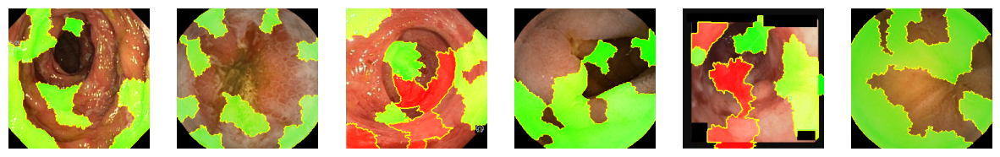

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1,6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_ViT.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_ViT, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 361.42it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.66it/s]


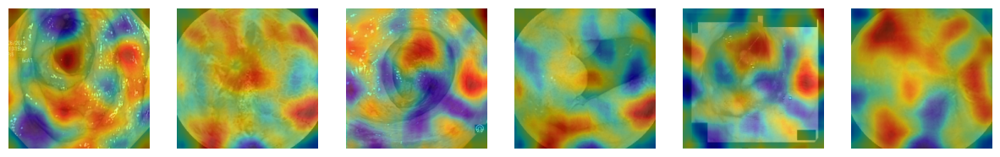

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivy</h3>

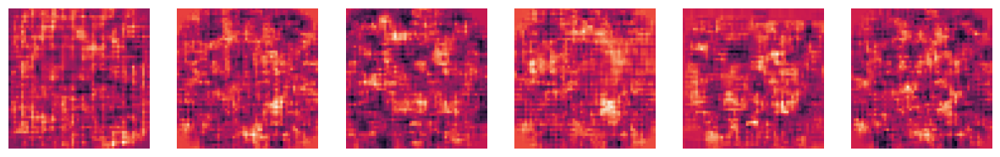

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_ViT, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/16

In [ ]:
vit_model_s16 = tfimm.create_model("vit_small_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_s16_preprocessing = tfimm.create_preprocessing("vit_small_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s16_preprocessing(x)
x = vit_model_s16.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s16 = Model(inputs, outputs)

In [ ]:
model_vit_s16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_s16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_s16 = model_vit_s16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 34s 637ms/step - loss: 0.1760 - accuracy: 0.9337 - val_loss: 0.0092 - val_accuracy: 0.9963
Epoch 2/200
27/27 [==============================] - 15s 549ms/step - loss: 0.0066 - accuracy: 0.9976 - val_loss: 0.0025 - val_accuracy: 1.0000
Epoch 3/200
27/27 [==============================] - 15s 557ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 0.0023 - val_accuracy: 1.0000
Epoch 4/200
27/27 [==============================] - 16s 584ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 0.0028 - val_accuracy: 0.9982
Epoch 5/200
27/27 [==============================] - 17s 590ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 0.0029 - val_accuracy: 0.9982
Epoch 6/200
27/27 [==============================] - 16s 594ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0018 - val_accuracy: 1.0000
Epoch 7/200
27/27 [==============================] - 16s 582ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.0013 - val_accuracy:

<Axes: >

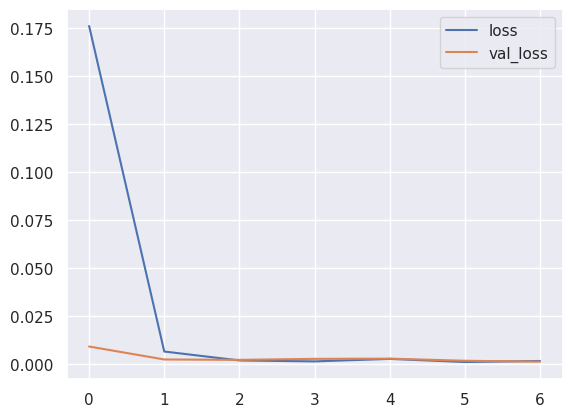

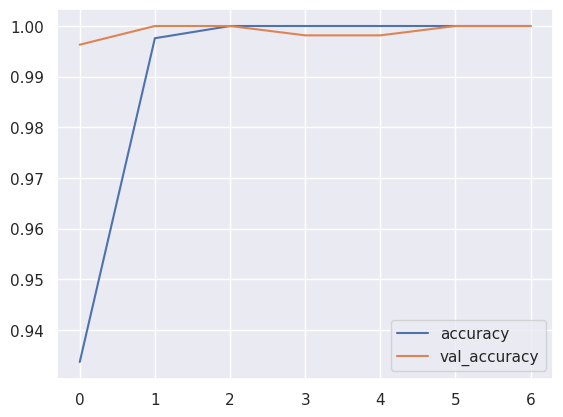

In [ ]:
model_history_s16 = pd.DataFrame(history_s16.history)
model_history_s16.loc[:, ['loss', 'val_loss']].plot()
model_history_s16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_s16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s16['val_loss'].mean()))

Accuracy for Train: 0.9902
Loss for Train: 0.0274
Accuracy for Test: 0.9989
Loss for Test: 0.0032


In [ ]:
start = time.time()
predict_labels_ = model_vit_s16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s16 = np.argmax(model_vit_s16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s16)))

Accuracy: 1.0000
Loss: 0.0018
Inference Time: 4.87s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


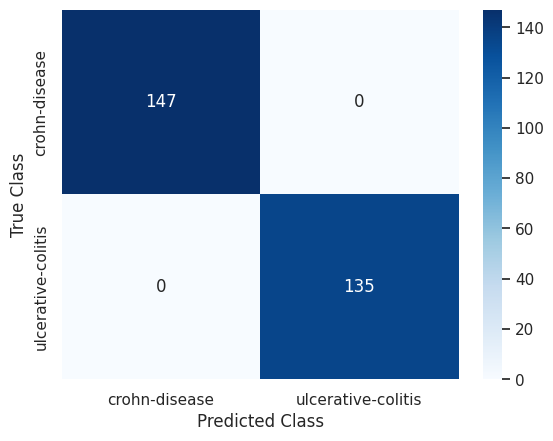

In [ ]:
conf_matrix_s16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s16)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 18s 333ms/step - accuracy: 0.6755 - student_loss: 0.8952 - distillation_loss: 13.0060 - val_accuracy: 0.8856 - val_student_loss: 0.0262
Epoch 2/100
27/27 [==============================] - 7s 248ms/step - accuracy: 0.8721 - student_loss: 0.4445 - distillation_loss: 7.4007 - val_accuracy: 0.9317 - val_student_loss: 0.2875
Epoch 3/100
27/27 [==============================] - 9s 304ms/step - accuracy: 0.9240 - student_loss: 0.2385 - distillation_loss: 5.6975 - val_accuracy: 0.9077 - val_student_loss: 0.3598
Epoch 4/100
27/27 [==============================] - 7s 249ms/step - accuracy: 0.9228 - student_loss: 0.2515 - distillation_loss: 5.2913 - val_accuracy: 0.9742 - val_student_loss: 0.0477
Epoch 5/100
27/27 [==============================] - 9s 304ms/step - accuracy: 0.9698 - student_loss: 0.1204 - distillation_loss: 3.9222 - val_accuracy: 0.9834 - val_student_loss: 0.0012
Epoch 6/100
27/27 [==============================] - 7s 251ms/s

<Axes: >

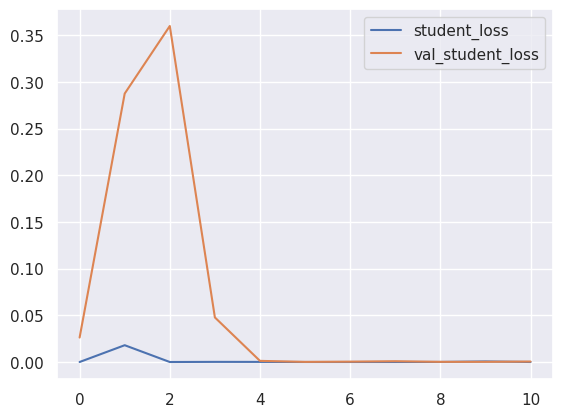

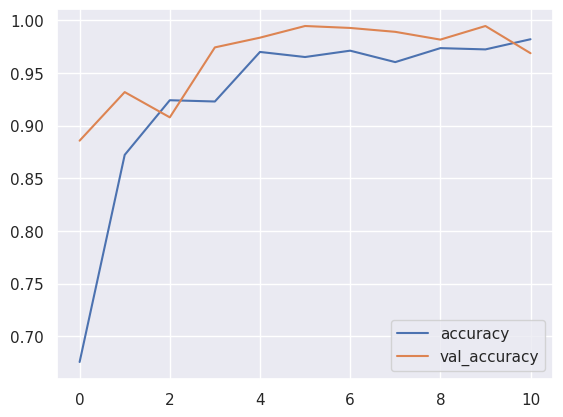

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9262
Loss for Train: 0.0017
Accuracy for Test: 0.9639
Loss for Test: 0.0659


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9787
Loss: 0.0924
Inference Time: 1.33s
Precision: 1.0000
Recall: 0.9556
F1-Score: 0.9773
AUC: 0.9778
MCC: 0.9582


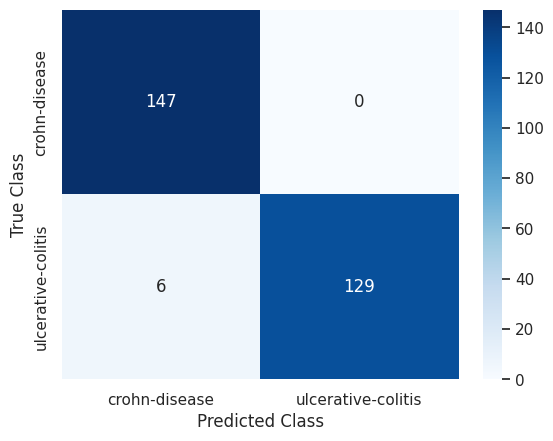

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 39s 540ms/step - accuracy: 0.4729 - student_loss: 0.8794 - distillation_loss: 0.8593 - val_accuracy: 0.5295 - val_student_loss: 0.6806 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 28s 524ms/step - accuracy: 0.5338 - student_loss: 0.7889 - distillation_loss: 0.8138 - val_accuracy: 0.5203 - val_student_loss: 0.6509 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 27s 495ms/step - accuracy: 0.5507 - student_loss: 0.7692 - distillation_loss: 0.7595 - val_accuracy: 0.8155 - val_student_loss: 0.5966 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 29s 524ms/step - accuracy: 0.5875 - student_loss: 0.7554 - distillation_loss: 0.7152 - val_accuracy: 0.8487 - val_student_loss: 0.5670 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 27s 494ms/step - accuracy: 0.6526 - student_loss: 0

<Axes: >

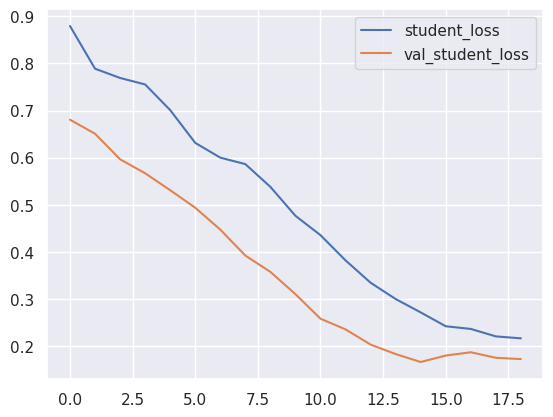

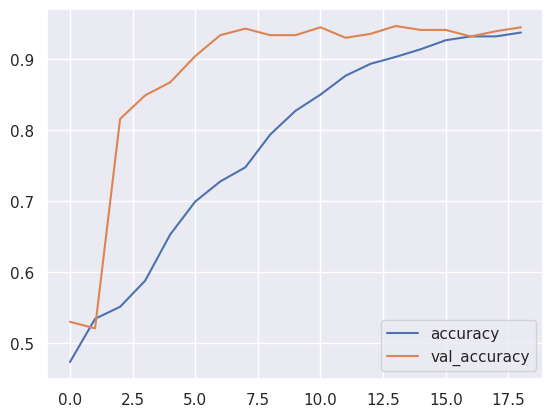

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7766
Loss for Train: 0.4930
Accuracy for Test: 0.8780
Loss for Test: 0.3574


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9397
Loss: 0.1884
Inference Time: 1.31s
Precision: 0.9758
Recall: 0.8963
F1-Score: 0.9344
AUC: 0.9379
MCC: 0.8815


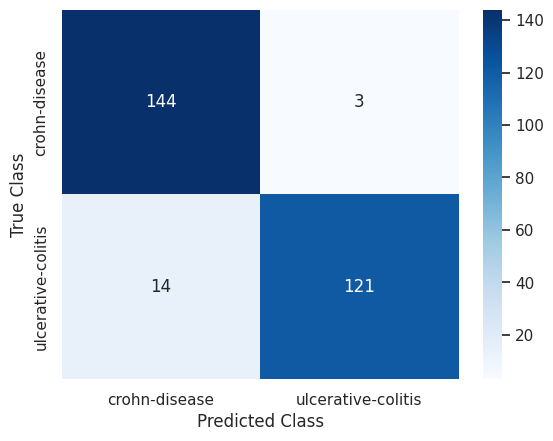

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

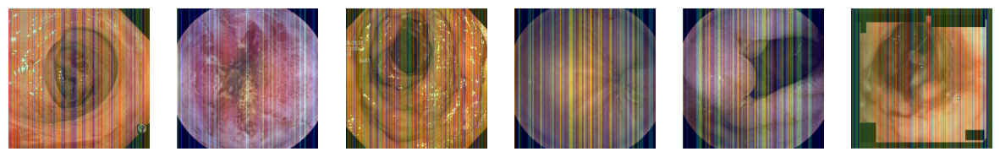

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s16.layers[-1].activation = None

  preds = model_vit_s16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

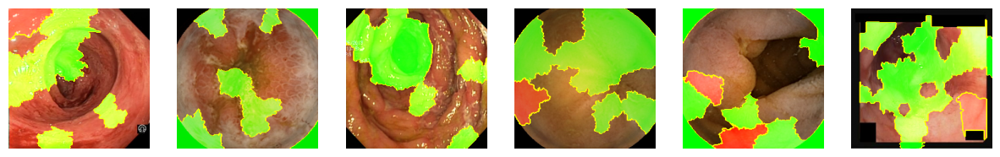

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


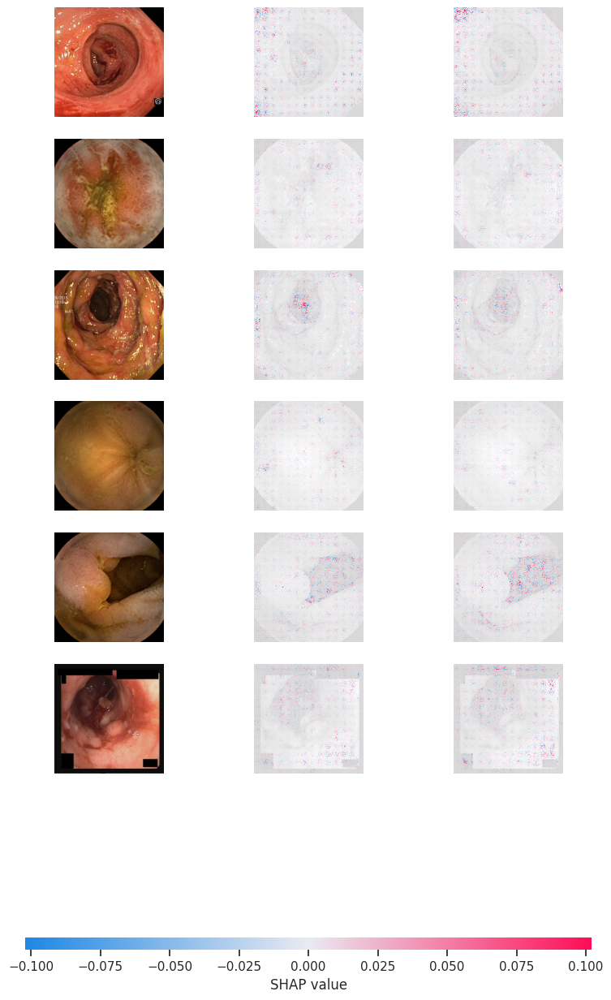

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s16, images_train_1).shap_values(image_interpretability_5_1)
shap.image_plot(shap_values, image_interpretability_5_1)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_s16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 290.16it/s]


Explaining: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s]


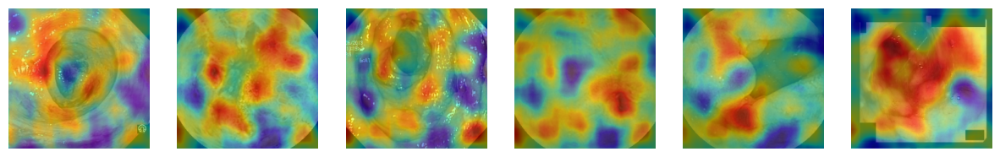

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

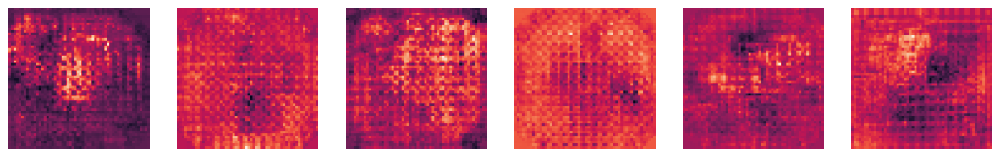

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_s16, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

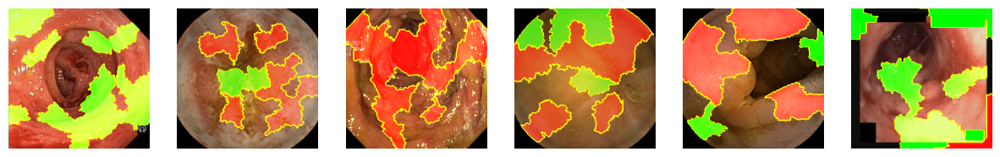

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 420.35it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.33it/s]


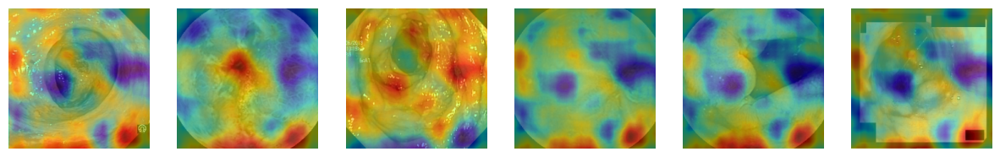

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

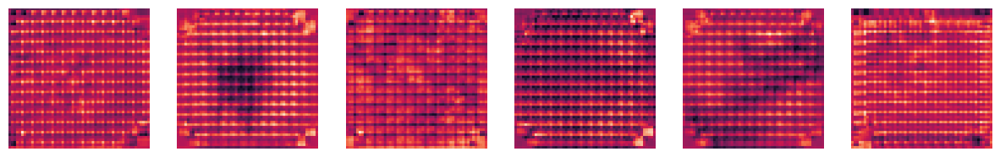

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

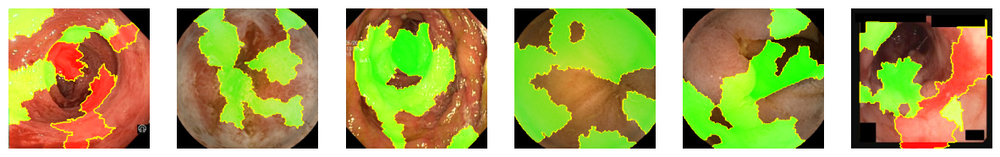

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 252.25it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 13.69it/s]


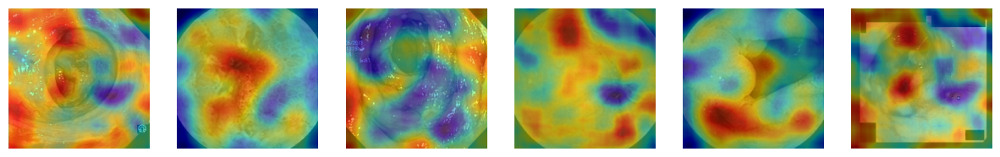

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

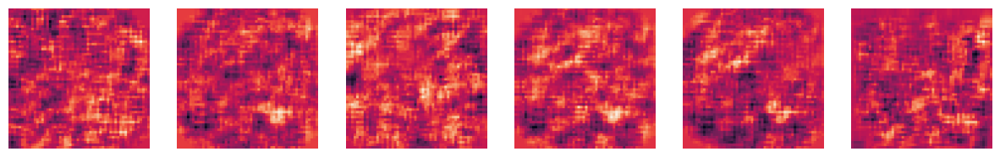

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# R26+S/32

In [12]:
vit_model_hybrid_s32 = tfimm.create_model("vit_small_r26_s32_224_in21k", pretrained=True, nb_classes=0)
vit_model_hybrid_s32_preprocessing = tfimm.create_preprocessing("vit_small_r26_s32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_hybrid_s32_preprocessing(x)
x = vit_model_hybrid_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_hybrid_s32 = Model(inputs, outputs)

In [13]:
model_vit_hybrid_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [14]:
model_vit_hybrid_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [15]:
history_hybrid_s32 = model_vit_hybrid_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 61s 1s/step - loss: 0.2795 - accuracy: 0.8758 - val_loss: 0.0204 - val_accuracy: 0.9982
Epoch 2/200
27/27 [==============================] - 19s 707ms/step - loss: 0.0156 - accuracy: 0.9940 - val_loss: 0.0163 - val_accuracy: 0.9982
Epoch 3/200
27/27 [==============================] - 20s 722ms/step - loss: 0.0027 - accuracy: 1.0000 - val_loss: 0.0195 - val_accuracy: 0.9963
Epoch 4/200
27/27 [==============================] - 20s 715ms/step - loss: 0.0079 - accuracy: 0.9988 - val_loss: 0.0277 - val_accuracy: 0.9945
Epoch 5/200
27/27 [==============================] - 20s 727ms/step - loss: 0.0027 - accuracy: 1.0000 - val_loss: 0.0258 - val_accuracy: 0.9908
Epoch 6/200
27/27 [==============================] - 21s 760ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 0.0381 - val_accuracy: 0.9871


<Axes: >

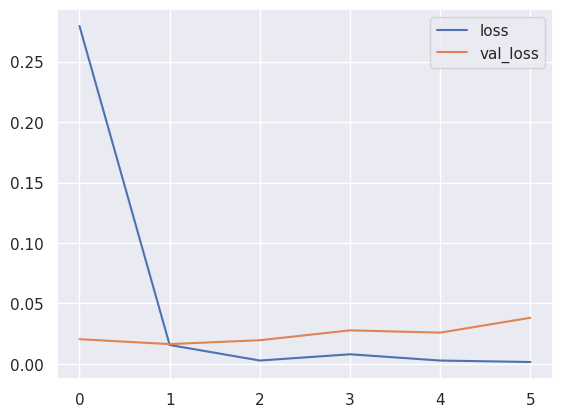

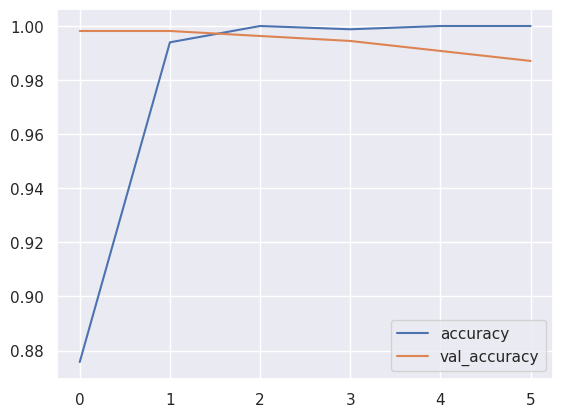

In [16]:
model_history_hybrid_s32 = pd.DataFrame(history_hybrid_s32.history)
model_history_hybrid_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_hybrid_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [17]:
print('Accuracy for Train: {:.4f}'.format(model_history_hybrid_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_hybrid_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_hybrid_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_hybrid_s32['val_loss'].mean()))

Accuracy for Train: 0.9781
Loss for Train: 0.0516
Accuracy for Test: 0.9942
Loss for Test: 0.0246


In [18]:
start = time.time()
predict_labels_ = model_vit_hybrid_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_hybrid_s32 = np.argmax(model_vit_hybrid_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_hybrid_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_hybrid_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_hybrid_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_hybrid_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_hybrid_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_hybrid_s32)))

Accuracy: 0.9787
Loss: 0.0480
Inference Time: 8.11s
Precision: 0.9574
Recall: 1.0000
F1-Score: 0.9783
AUC: 0.9796
MCC: 0.9583


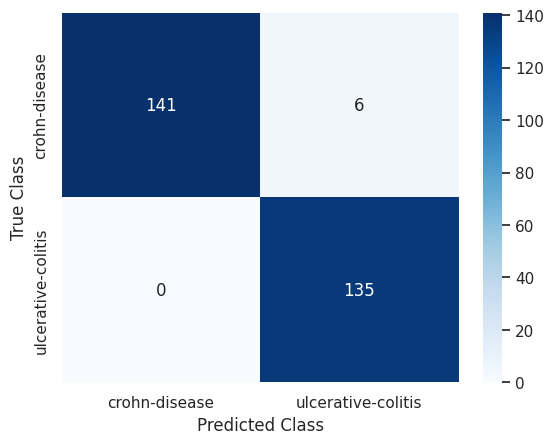

In [19]:
conf_matrix_hybrid_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_hybrid_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_hybrid_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [20]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_hybrid_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Knowledge Distillation</h1>

In [21]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_hybrid_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [22]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 21s 314ms/step - accuracy: 0.5151 - student_loss: 1.2325 - distillation_loss: 9.0961 - val_accuracy: 0.7472 - val_student_loss: 0.5319
Epoch 2/100
27/27 [==============================] - 9s 301ms/step - accuracy: 0.6019 - student_loss: 0.9773 - distillation_loss: 7.5406 - val_accuracy: 0.9557 - val_student_loss: 0.0975
Epoch 3/100
27/27 [==============================] - 9s 332ms/step - accuracy: 0.8094 - student_loss: 0.5203 - distillation_loss: 5.6009 - val_accuracy: 0.8266 - val_student_loss: 0.3365
Epoch 4/100
27/27 [==============================] - 9s 292ms/step - accuracy: 0.8420 - student_loss: 0.4355 - distillation_loss: 4.9005 - val_accuracy: 0.9649 - val_student_loss: 0.0394
Epoch 5/100
27/27 [==============================] - 9s 336ms/step - accuracy: 0.9095 - student_loss: 0.2463 - distillation_loss: 3.5346 - val_accuracy: 0.9852 - val_student_loss: 8.2977e-04
Epoch 6/100
27/27 [==============================] - 8s 278m

<Axes: >

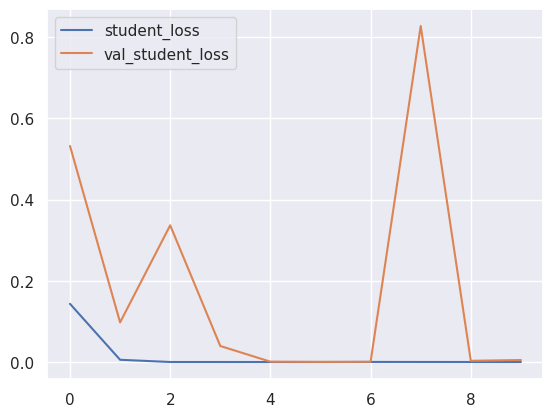

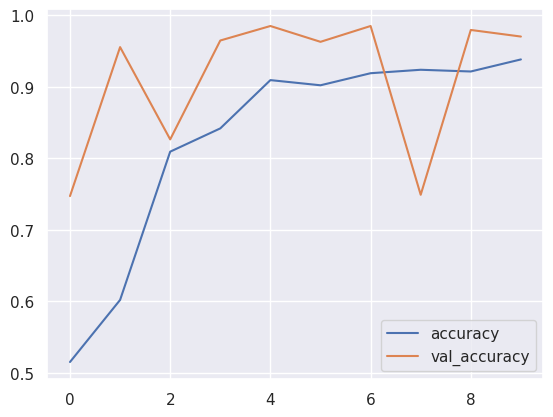

In [23]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [24]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8283
Loss for Train: 0.0149
Accuracy for Test: 0.9127
Loss for Test: 0.1842


In [25]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9645
Loss: 0.0733
Inference Time: 1.56s
Precision: 0.9921
Recall: 0.9333
F1-Score: 0.9618
AUC: 0.9633
MCC: 0.9303


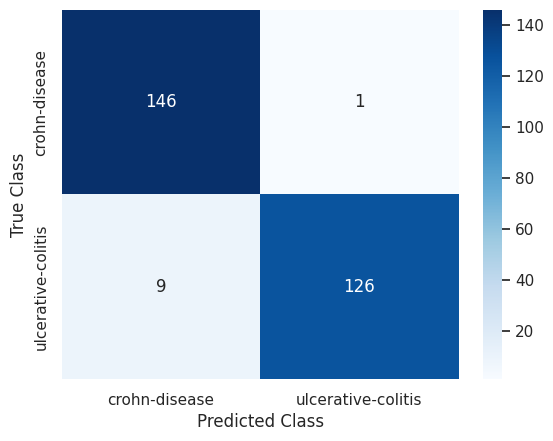

In [26]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [27]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [28]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [29]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_hybrid_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [30]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 39s 485ms/step - accuracy: 0.5121 - student_loss: 0.9334 - distillation_loss: 0.9423 - val_accuracy: 0.7140 - val_student_loss: 0.6587 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 27s 488ms/step - accuracy: 0.5380 - student_loss: 0.8136 - distillation_loss: 0.8087 - val_accuracy: 0.7712 - val_student_loss: 0.6116 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 26s 483ms/step - accuracy: 0.5929 - student_loss: 0.7338 - distillation_loss: 0.7263 - val_accuracy: 0.9244 - val_student_loss: 0.5500 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 25s 458ms/step - accuracy: 0.6671 - student_loss: 0.6703 - distillation_loss: 0.6778 - val_accuracy: 0.9170 - val_student_loss: 0.4875 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 26s 483ms/step - accuracy: 0.7322 - student_loss: 0

<Axes: >

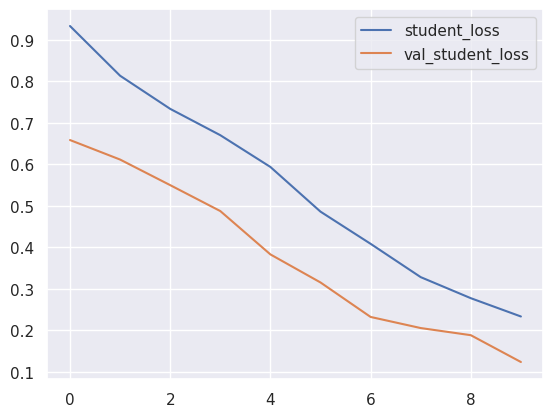

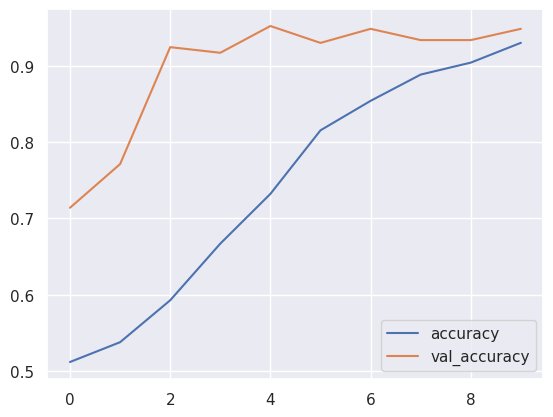

In [31]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [32]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7434
Loss for Train: 0.5479
Accuracy for Test: 0.8972
Loss for Test: 0.3757


In [33]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9397
Loss: 0.1539
Inference Time: 1.11s
Precision: 0.9609
Recall: 0.9111
F1-Score: 0.9354
AUC: 0.9385
MCC: 0.8801


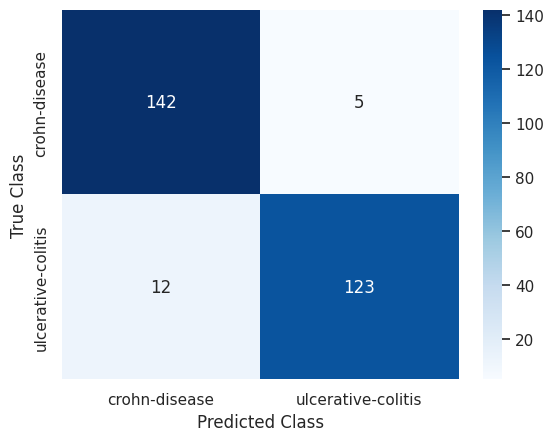

In [34]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [35]:
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

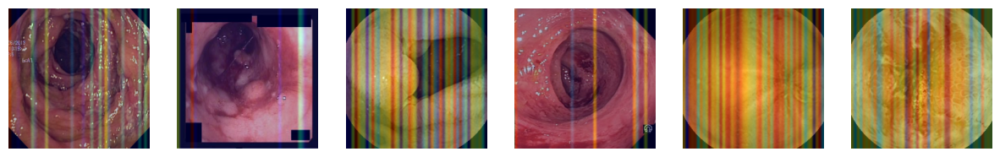

In [36]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_hybrid_s32.layers[-1].activation = None

  preds = model_vit_hybrid_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_hybrid_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

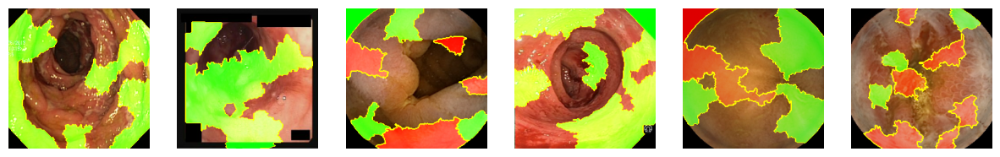

In [37]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_hybrid_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


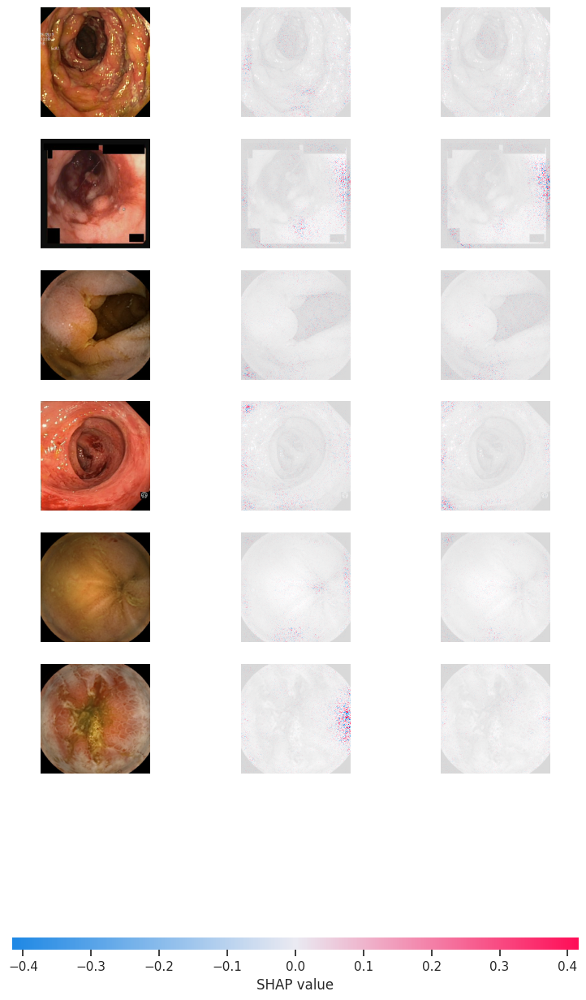

In [38]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_hybrid_s32, images_train_1).shap_values(image_interpretability_5_1)
shap.image_plot(shap_values, image_interpretability_5_1)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [39]:
model_rise = RISE(1000, 8, 0.5, model_vit_hybrid_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 255.66it/s]


Explaining: 100%|██████████| 32/32 [00:09<00:00,  3.24it/s]


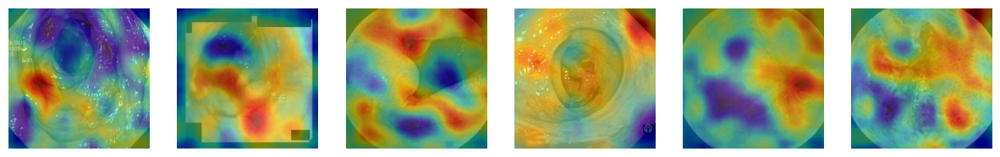

In [40]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

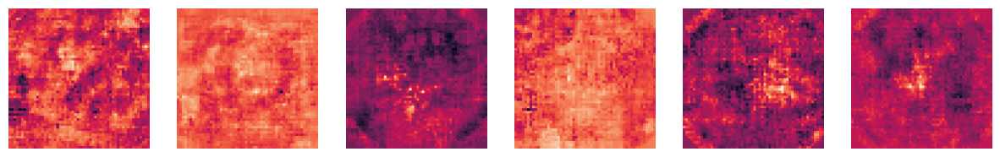

In [41]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_hybrid_s32, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

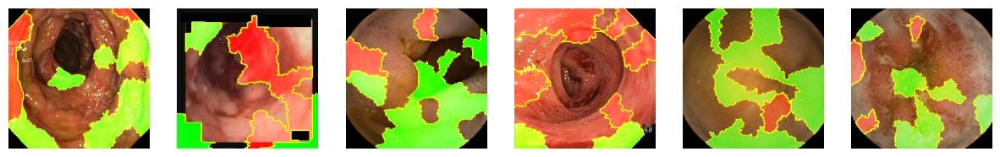

In [42]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [43]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 333.83it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.59it/s]


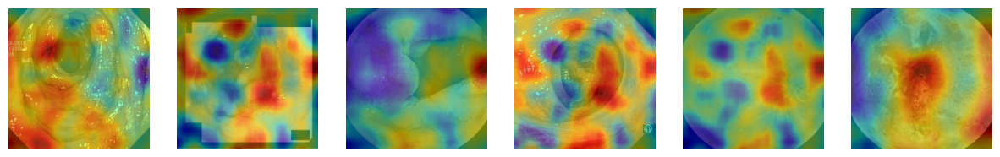

In [44]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

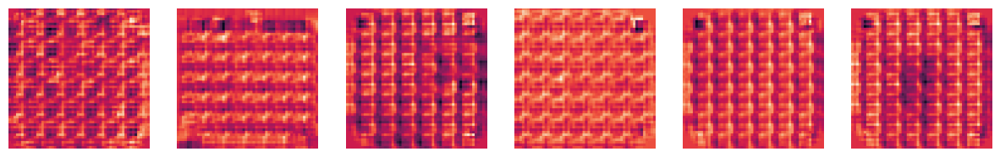

In [45]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

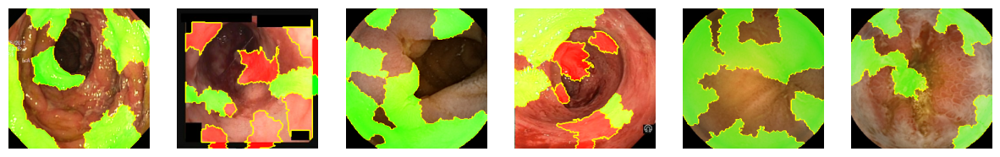

In [46]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [47]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 260.22it/s]


Explaining: 100%|██████████| 32/32 [00:01<00:00, 16.14it/s]


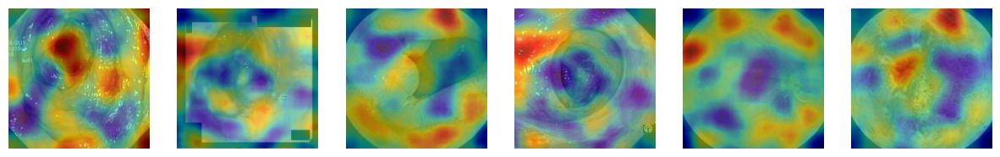

In [48]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_5_1[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

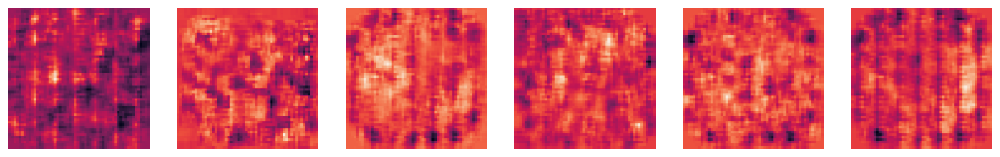

In [49]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_5_1, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_5_1[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1